In [81]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [82]:
train_redu = pd.read_csv('dataset/train_redu.csv')
test_redu = pd.read_csv('dataset/test_redu.csv')
train_1xtds = pd.read_csv('dataset/train_1xtds.csv')

x_train = [(x,y) for x, y in zip(train_redu['intensidade'], train_redu['simetria'])]
y_train = train_redu['label']

x_test = [(x,y) for x, y in zip(test_redu['intensidade'], test_redu['simetria'])]
y_test = test_redu['label']

In [83]:
#transformando em vetor para poder aplicar metodos
x_train = np.array(x_train)
y_train = np.array(y_train)
x_test = np.array(x_test)
y_test = np.array(y_test)

x_train = x_train.T
x_test = x_test.T
y_test = y_test.reshape(1, -1)
y_train = y_train.reshape(1, -1)

In [84]:
print("Shape of x_train : ", x_train.shape)
print("Shape of y_train : ", y_train.shape)
print("Shape of x_test : ", x_test.shape)
print("Shape of y_test : ", y_test.shape)

Shape of x_train :  (2, 2186)
Shape of y_train :  (1, 2186)
Shape of x_test :  (2, 1115)
Shape of y_test :  (1, 1115)


### 1 x todos

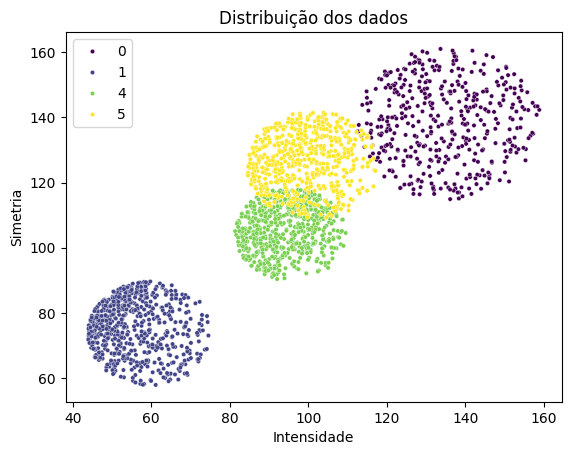

In [100]:
sns.scatterplot(x='intensidade', y='simetria', hue='label', data=train_redu, palette='viridis', s=10)

plt.xlabel('Intensidade')
plt.ylabel('Simetria')
plt.title('Distribuição dos dados')
plt.legend()
plt.show()

In [86]:
classes = np.unique(y_train)
y_train_bin = {}

for i, cls in enumerate(classes):
    print(i, cls)
    if cls == 0:
        y_train_bin[cls] = np.where(y_train == cls, 0, 1)

y_train_bin

0 0
1 1
2 4
3 5


{np.int64(0): array([[0, 0, 0, ..., 1, 1, 1]])}

### Funções

In [87]:
def sigmoide(x):
    return 1/(1 + np.exp(-x))

In [88]:
def acuracia(y, pred, conjunto):

    total = len(y[0])

    acertos = 0

    for i in range(total):
        if pred[0][i] == y[0][i]:
            acertos += 1
    
    print(f"Acuracia do modelo no conjunto {conjunto}: ", (acertos/total)*100, "%")

In [96]:
def regressao_logistica(X, Y, titulo, learning_rate = 0.0015, iterations = 100000):
    
    #numero de amostras
    m = x_train.shape[1]
    print('m:', m)
    
    #numero de features
    n = x_train.shape[0]
    print('n:', n)
    
    #matriz de pesos
    W = np.zeros((n,1))
    print('W:', W)

    #bias
    B = 0
    
    cost_list = []

    print(f'para o conjunto de {titulo}')
    print('')
    
    for i in range(iterations):
        
        #forward propagation
        Z = np.dot(W.T, X) + B
        print('Z:', Z)

        #sigmoid
        A = sigmoide(Z)
        print('A:', A)

        #custo
        cost = -(1/m)*np.sum( Y*np.log(A) + (1-Y)*np.log(1-A))
        print('cost:', cost)
        
        #gradiente descendente
        dW = (1/m)*np.dot(A-Y, X.T)
        print('dW:', dW)
        dB = (1/m)*np.sum(A - Y)
        print('dB:', dB)
        
        W = W - learning_rate*dW.T
        print('W:', W)
        B = B - learning_rate*dB
        print('B:', B)
        
        #historico de custo
        cost_list.append(cost)
        

        if(i%(iterations/10) == 0):
            print(f"custo depois de {i} iterações:", cost)


    print('')
    #predições    
    Z_final = np.dot(W.T, X) + B
    A_final = sigmoide(Z_final)
    
    y_pred = np.where(A_final >= 0.5, 1, 0)

    return W, B, cost_list, y_pred
        

In [98]:
W, B, hist_custo, y_pred_treino = {}, {}, {}, {}

for cls in classes:
    if cls == 0:
        print(f"Treinando para a classe {cls}")
        W[cls], B[cls], hist_custo[cls], y_pred_treino[cls] = regressao_logistica(x_train, y_train_bin[cls], cls)

Treinando para a classe 0
m: 2186
n: 2
W: [[0.]
 [0.]]
para o conjunto de 0

Z: [[0. 0. 0. ... 0. 0. 0.]]
A: [[0.5 0.5 0.5 ... 0.5 0.5 0.5]]
cost: 0.6931471805599453
dW: [[-20.14658971 -27.66428789]]
dB: -0.30558096980786825
W: [[0.03021988]
 [0.04149643]]
B: 0.0004583714547118024
custo depois de 0 iterações: 0.6931471805599453
Z: [[10.56072682  9.27355599  9.41899028 ...  8.86700154  8.48512508
   8.92460455]]
A: [[0.99997409 0.99990613 0.99991884 ... 0.99985906 0.99979353 0.99986694]]
cost: 1.9099780297280944
dW: [[26.01481893 26.69193686]]
dB: 0.19172556944739746
W: [[-0.00880234]
 [ 0.00145853]]
B: 0.00017078310054070622
Z: [[-1.06330367 -0.84359607 -0.9274971  ... -0.78063302 -0.68140636
  -0.6843732 ]]
A: [[0.25667862 0.30077795 0.28343278 ... 0.31418347 0.33594749 0.33528595]]
cost: 0.8882895786837531
dW: [[-36.03342579 -45.76715334]]
dB: -0.46226373748393473
W: [[0.04524779]
 [0.07010926]]
B: 0.0008641787067666083
Z: [[16.99780149 14.97912935 15.17242244 ... 14.33774147 13.7588

KeyboardInterrupt: 

In [91]:
y_pred_treino[0][0]

array([1, 1, 1, ..., 1, 1, 1])

In [92]:
len(train_1xtds)

2186

In [93]:
indices_mantem = []

for i in range(len(train_1xtds)):
    if(y_pred_treino[0][0][i] == 1):
        indices_mantem.append(i)

train_redu_1 = train_1xtds.iloc[indices_mantem]

len(train_redu_1)

2105

In [94]:
x_train_1 = [(x,y) for x, y in zip(train_redu_1['intensidade'], train_redu_1['simetria'])]
y_train_1 = train_redu_1['label']

x_train_1 = np.array(x_train_1)
y_train_1 = np.array(y_train_1)

x_train_1 = x_train_1.T
y_train_1 = y_train_1.reshape(1, -1)

print("Shape of x_train_1 : ", x_train_1.shape)
print("Shape of y_train_1 : ", y_train_1.shape)

Shape of x_train_1 :  (2, 2105)
Shape of y_train_1 :  (1, 2105)


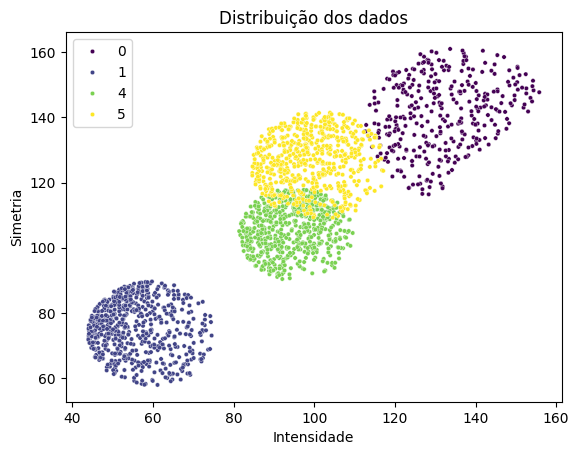

In [99]:
sns.scatterplot(x='intensidade', y='simetria', hue='label', data=train_redu_1, palette='viridis', s=10)

plt.xlabel('Intensidade')
plt.ylabel('Simetria')
plt.title('Distribuição dos dados')
plt.legend()
plt.show()

In [110]:
train_redu['label'].value_counts()

label
1    608
4    577
5    576
0    425
Name: count, dtype: int64

In [109]:
train_redu_1['label'].value_counts()


label
1    608
4    577
5    576
0    344
Name: count, dtype: int64

In [102]:
y_train_1

array([[0, 0, 0, ..., 5, 5, 5]])

In [101]:
for i, cls in enumerate(classes):
    print(i, cls)
    if cls == 1:
        y_train_bin[cls] = np.where(y_train_1 == cls, 0, 1)

y_train_bin

0 0
1 1
2 4
3 5


{np.int64(0): array([[0, 0, 0, ..., 1, 1, 1]]),
 np.int64(1): array([[1, 1, 1, ..., 1, 1, 1]])}

In [97]:
for cls in classes:
    if cls == 1:
        print(f"Treinando para a classe {cls}")
        W[cls], B[cls], hist_custo[cls], y_pred_treino[cls] = regressao_logistica(x_train_1, y_train_1, cls)

Treinando para a classe 1
m: 2186
n: 2
W: [[0.]
 [0.]]
para o conjunto de 1

Z: [[0. 0. 0. ... 0. 0. 0.]]
A: [[0.5 0.5 0.5 ... 0.5 0.5 0.5]]
cost: 0.6674633188832044
dW: [[-201.85763863 -247.11690257]]
dB: -2.1699451052150045
W: [[0.30278646]
 [0.37067535]]
B: 0.003254917657822507
custo depois de 0 iterações: 0.6674633188832044
Z: [[99.11127466 86.73128316 88.32674791 ... 82.84246109 79.05623837
  83.04328204]]
A: [[1. 1. 1. ... 1. 1. 1.]]
cost: nan
dW: [[-158.25999139 -194.91036722]]
dB: -1.6884720951509606
W: [[0.54017645]
 [0.6630409 ]]
B: 0.005787625800548948
Z: [[177.0761851  154.97001257 157.81098516 ... 148.02512211 141.26888269
  148.39798966]]
A: [[1. 1. 1. ... 1. 1. 1.]]
cost: nan
dW: [[-158.25999139 -194.91036722]]
dB: -1.6884720951509606
W: [[0.77756643]
 [0.95540646]]
B: 0.00832033394327539
Z: [[255.04109553 223.20874197 227.29522241 ... 213.20778313 203.48152702
  213.75269729]]
A: [[1. 1. 1. ... 1. 1. 1.]]
cost: nan
dW: [[-158.25999139 -194.91036722]]
dB: -1.688472095150

C:\Users\kamil\AppData\Local\Temp\ipykernel_22380\3976984985.py:34: RuntimeWarning: divide by zero encountered in log
  cost = -(1/m)*np.sum( Y*np.log(A) + (1-Y)*np.log(1-A))
C:\Users\kamil\AppData\Local\Temp\ipykernel_22380\3976984985.py:34: RuntimeWarning: invalid value encountered in multiply
  cost = -(1/m)*np.sum( Y*np.log(A) + (1-Y)*np.log(1-A))


Z: [[16471.74246555 14416.86445905 14680.01657047 ... 13771.20127523
  13143.71154684 13807.5318827 ]]
A: [[1. 1. 1. ... 1. 1. 1.]]
cost: nan
dW: [[-158.25999139 -194.91036722]]
dB: -1.6884720951509606
W: [[50.39207373]
 [62.05980658]]
B: 0.5376563357731008
Z: [[16549.70737598 14485.10318846 14749.50080773 ... 13836.38393625
  13205.92419117 13872.88659032]]
A: [[1. 1. 1. ... 1. 1. 1.]]
cost: nan
dW: [[-158.25999139 -194.91036722]]
dB: -1.6884720951509606
W: [[50.62946372]
 [62.35217213]]
B: 0.5401890439158272
Z: [[16627.67228641 14553.34191786 14818.98504498 ... 13901.56659727
  13268.13683549 13938.24129794]]
A: [[1. 1. 1. ... 1. 1. 1.]]
cost: nan
dW: [[-158.25999139 -194.91036722]]
dB: -1.6884720951509606
W: [[50.86685371]
 [62.64453768]]
B: 0.5427217520585537
Z: [[16705.63719685 14621.58064727 14888.46928223 ... 13966.74925829
  13330.34947982 14003.59600556]]
A: [[1. 1. 1. ... 1. 1. 1.]]
cost: nan
dW: [[-158.25999139 -194.91036722]]
dB: -1.6884720951509606
W: [[51.10424369]
 [62.9

KeyboardInterrupt: 

### Vizualização Gráfica

Linha de Decisão:

$$y = -\left(\frac{W[0] * x + B}{W[1]}\right)$$

Onde:
<br>
- $W[i] (pesos) ajustam a inclinação da reta <br>
- $B$ (bias) ajusta a posição da reta no gráfico <br>
- $x$ representa a lista ($x_{min}$, $x_{max}$)


In [11]:
def linha_decisao(W, B, X):
    
    #limites
    x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
    
    y_min = float(-(W[0] * x_min + B) / W[1])
    y_max = float(-(W[0] * x_max + B) / W[1])

    coord_min = (x_min, y_min)
    coord_max = (x_max, y_max)

    #linha de decisao
    coord = [coord_min, coord_max]

    for cod in coord:
        print(f"Ponto: {cod}")
    
    return coord

In [12]:
linhas = []

for cls in classes:
    linhas.append(linha_decisao(W[cls], B[cls], x_train))

linhas[0]

Ponto: (np.float64(144.43529411764706), 132.2072999239943)
Ponto: (np.float64(149.57254901960783), 137.91332784535638)
Ponto: (np.float64(144.43529411764706), 1483.667614072432)
Ponto: (np.float64(149.57254901960783), 1579.0173859728625)
Ponto: (np.float64(144.43529411764706), 27.493623902672905)
Ponto: (np.float64(149.57254901960783), 28.169351936167228)
Ponto: (np.float64(144.43529411764706), 140.72291864550513)
Ponto: (np.float64(149.57254901960783), 144.72324982821453)


C:\Users\kamil\AppData\Local\Temp\ipykernel_22380\3706030843.py:6: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_min = float(-(W[0] * x_min + B) / W[1])
C:\Users\kamil\AppData\Local\Temp\ipykernel_22380\3706030843.py:7: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_max = float(-(W[0] * x_max + B) / W[1])


[(np.float64(144.43529411764706), 132.2072999239943),
 (np.float64(149.57254901960783), 137.91332784535638)]

(np.float64(144.43529411764706), 132.2072999239943)

(np.float64(149.57254901960783), 137.91332784535638)
(np.float64(144.43529411764706), 1483.667614072432)

(np.float64(149.57254901960783), 1579.0173859728625)
(np.float64(144.43529411764706), 27.493623902672905)

(np.float64(149.57254901960783), 28.169351936167228)
(np.float64(144.43529411764706), 140.72291864550513)

(np.float64(149.57254901960783), 144.72324982821453)


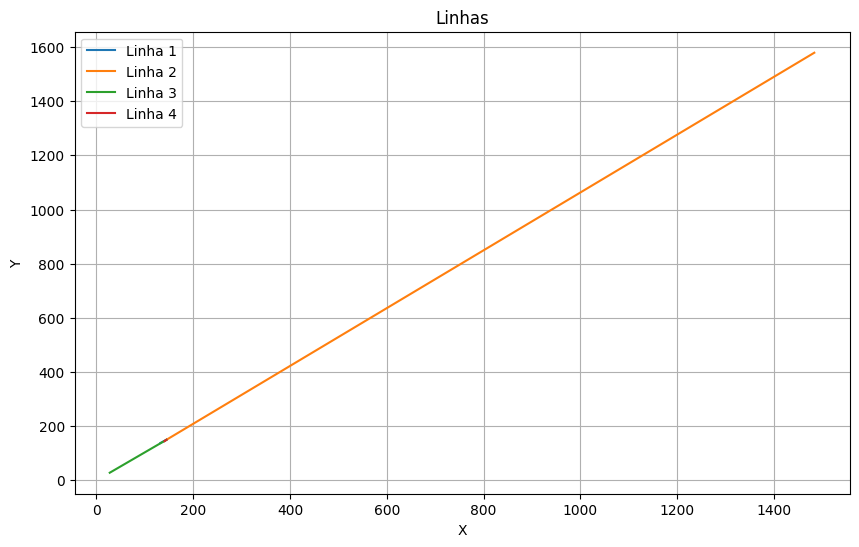

In [13]:
plt.figure(figsize=(10, 6))

for linha in linhas:
    x_values, y_values = linha
    print(x_values)
    print('')
    print(y_values)
    plt.plot(x_values, y_values, label='Linha de Decisão')

plt.xlabel('X')
plt.ylabel('Y')
plt.title('Linhas')
plt.legend(['Linha 1', 'Linha 2', 'Linha 3', 'Linha 4'])
plt.grid(True)
plt.show()

In [14]:
def classificacao_plot(W, B, X, y, y_pred, classe):
    
    x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
    
    y_values = -(W[0] * np.array([x_min, x_max]) + B) / W[1]
    
    plt.plot([x_min, x_max], y_values, color='green', label='Linha de Decisão')

    plt.scatter(X[:, 0], X[:, 1], c=y, marker='o', label='Dados Reais')    
    plt.scatter(X[:, 0], X[:, 1], c=y_pred, marker='x', label='Predições', alpha=0.6)

    plt.xlabel('Intensidade')
    plt.ylabel('Simetria')
    plt.title(f'Treinamento e Decisão da Classe {classe}')
    plt.legend()
    plt.show()

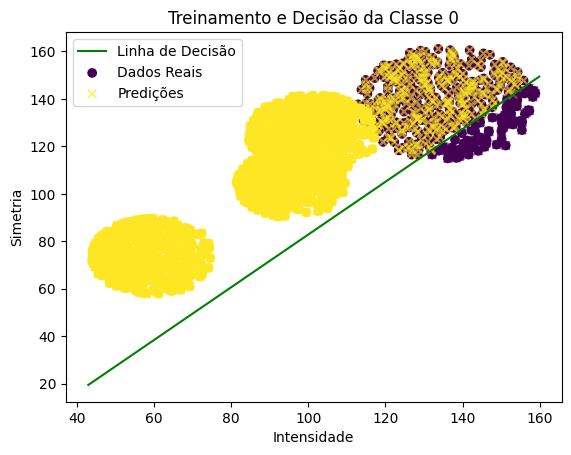

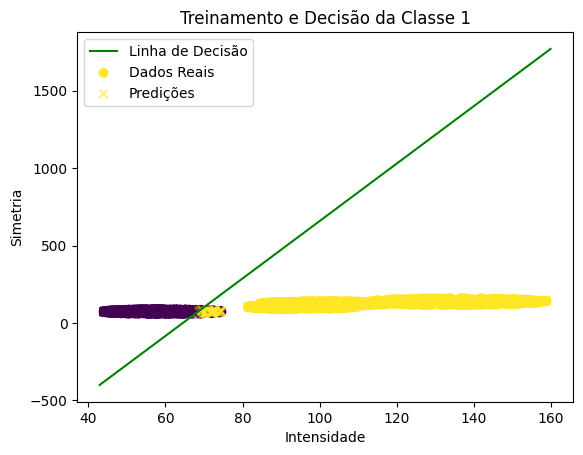

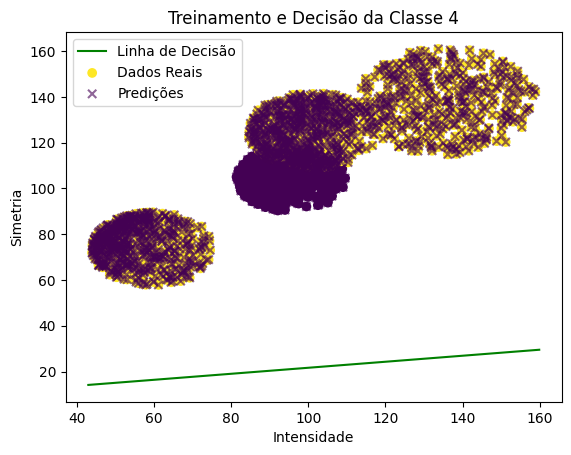

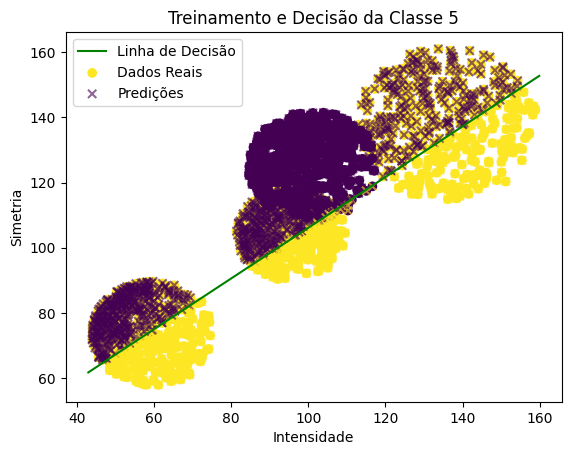

In [15]:
for cls in classes:
    classificacao_plot(W[cls], B[cls], x_train.T, y_train_bin[cls].flatten(), y_pred_treino[cls].flatten(), cls)

In [16]:
def teste_plot(W, B, X, cls):
    
    x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
    
    y_values = -(W[0] * np.array([x_min, x_max]) + B) / W[1]
    
    plt.plot([x_min, x_max], y_values, label=f'linha {cls}')

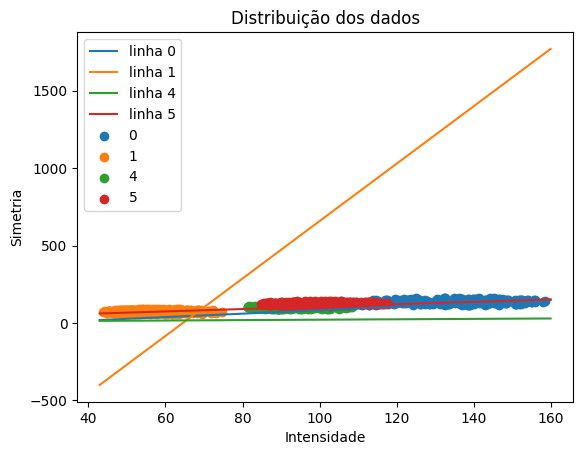

In [17]:
for cls in classes:
    teste_plot(W[cls], B[cls], x_train.T, cls)


filtrado = test_redu[test_redu['label'].isin([0, 1, 4, 5])]

label_0 = filtrado[filtrado['label'] == 0]
label_1 = filtrado[filtrado['label'] == 1]
label_4 = filtrado[filtrado['label'] == 4]
label_5 = filtrado[filtrado['label'] == 5]

plt.scatter(label_0['intensidade'], label_0['simetria'], label='0')
plt.scatter(label_1['intensidade'], label_1['simetria'], label='1')
plt.scatter(label_4['intensidade'], label_4['simetria'], label='4')
plt.scatter(label_5['intensidade'], label_5['simetria'], label='5')
plt.xlabel('Intensidade')
plt.ylabel('Simetria')
plt.title('Distribuição dos dados')
plt.legend()
plt.show()

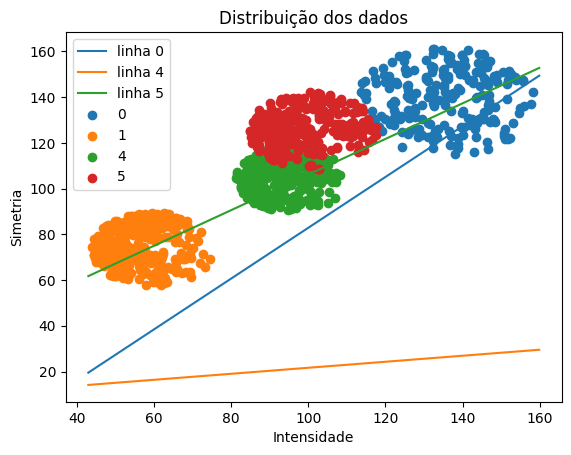

In [18]:
for cls in classes:
    if cls != 1:
        teste_plot(W[cls], B[cls], x_train.T, cls)


filtrado = test_redu[test_redu['label'].isin([0, 1, 4, 5])]

label_0 = filtrado[filtrado['label'] == 0]
label_1 = filtrado[filtrado['label'] == 1]
label_4 = filtrado[filtrado['label'] == 4]
label_5 = filtrado[filtrado['label'] == 5]

plt.scatter(label_0['intensidade'], label_0['simetria'], label='0')
plt.scatter(label_1['intensidade'], label_1['simetria'], label='1')
plt.scatter(label_4['intensidade'], label_4['simetria'], label='4')
plt.scatter(label_5['intensidade'], label_5['simetria'], label='5')
plt.xlabel('Intensidade')
plt.ylabel('Simetria')
plt.title('Distribuição dos dados')
plt.legend()
plt.show()

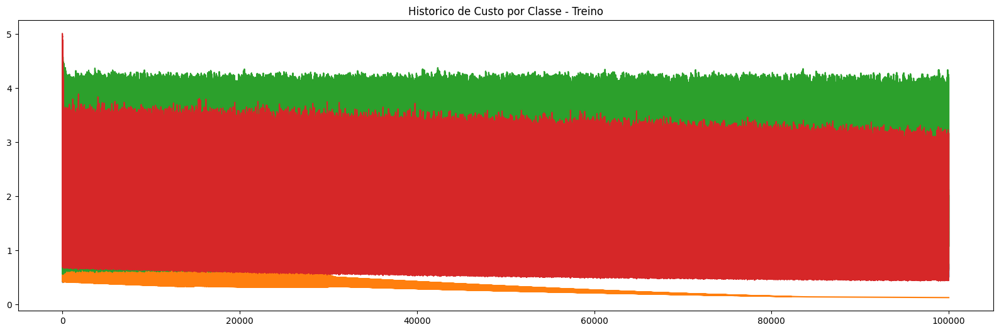

In [19]:
iteracoes = 100000

plt.figure(figsize=(20,6))

for cls in classes:
    plt.plot(np.arange(iteracoes), hist_custo[cls])
    
plt.title(f'Historico de Custo por Classe - Treino')
plt.show()

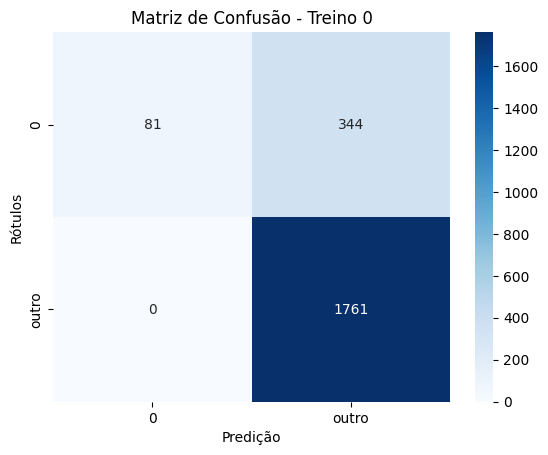

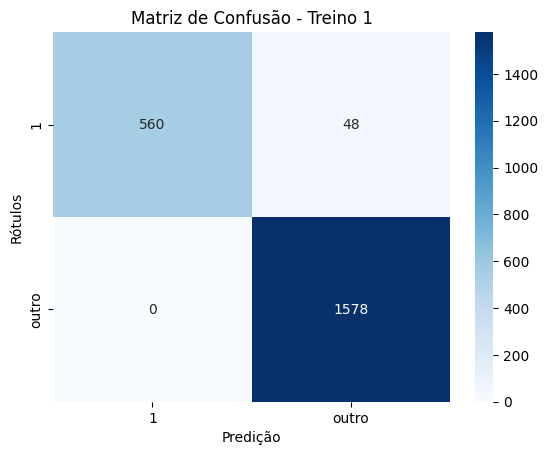

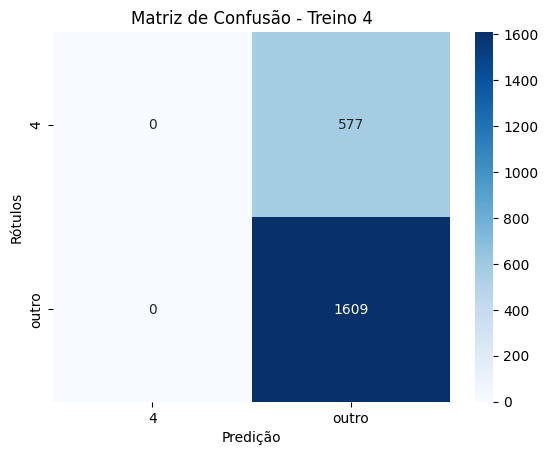

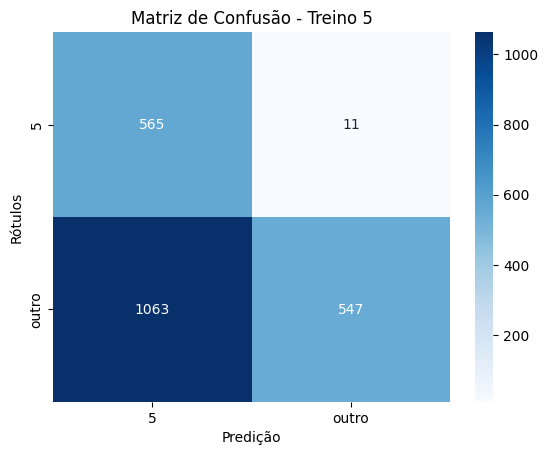

In [20]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

for cls in classes:  

    #convertendo em vetores 1D
    y_train_f = y_train_bin[cls].flatten()
    y_pred_f = y_pred_treino[cls].flatten()

    cm = confusion_matrix(y_train_f, y_pred_f)

    sns.heatmap(cm, annot=True, fmt='d',
                cmap='Blues',
                xticklabels=[cls, 'outro'], 
                yticklabels=[cls, 'outro'])
    
    plt.xlabel('Predição')
    plt.ylabel('Rótulos')
    plt.title(f'Matriz de Confusão - Treino {cls}')
    plt.show()


              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0
           6       0.00      0.00      0.00         0
           7       0.00      0.00      0.00         0
           8       0.00      0.00      0.00         0
           9       0.00      0.00      0.00         0
          10       0.00      0.00      0.00         0
          11       0.00      0.00      0.00         0
          12       0.00      0.00      0.00         0
          13       0.00      0.00      0.00         0
          14       0.00      0.00      0.00         0
          15       0.00      0.00      0.00         0
          16       0.00      0.00      0.00         0
          17       0.00    

C:\Users\kamil\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\kamil\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\kamil\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\metrics\_classification.py:15

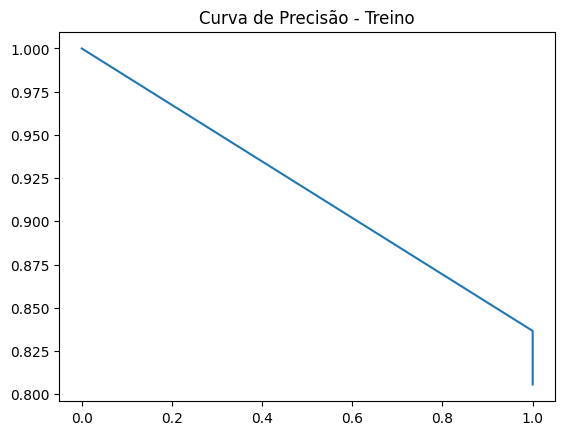

C:\Users\kamil\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\kamil\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\kamil\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\metrics\_classification.py:15

              precision    recall  f1-score   support

           0       1.00      1.00      1.00         1
           1       1.00      1.00      1.00         1
           2       1.00      1.00      1.00         1
           3       1.00      1.00      1.00         1
           4       1.00      1.00      1.00         1
           5       1.00      1.00      1.00         1
           6       1.00      1.00      1.00         1
           7       1.00      1.00      1.00         1
           8       1.00      1.00      1.00         1
           9       1.00      1.00      1.00         1
          10       1.00      1.00      1.00         1
          11       1.00      1.00      1.00         1
          12       1.00      1.00      1.00         1
          13       1.00      1.00      1.00         1
          14       1.00      1.00      1.00         1
          15       1.00      1.00      1.00         1
          16       1.00      1.00      1.00         1
          17       1.00    

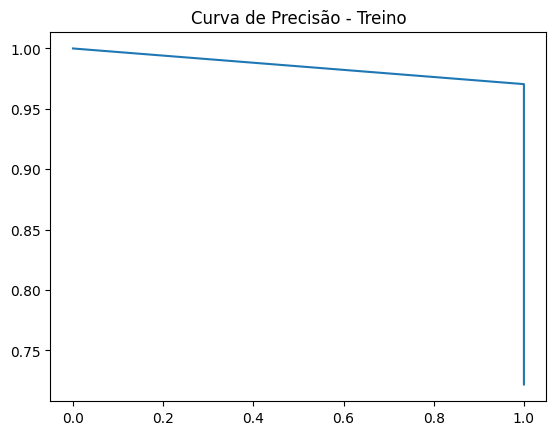

              precision    recall  f1-score   support

           0       1.00      1.00      1.00         1
           1       1.00      1.00      1.00         1
           2       1.00      1.00      1.00         1
           3       1.00      1.00      1.00         1
           4       1.00      1.00      1.00         1
           5       1.00      1.00      1.00         1
           6       1.00      1.00      1.00         1
           7       1.00      1.00      1.00         1
           8       1.00      1.00      1.00         1
           9       1.00      1.00      1.00         1
          10       1.00      1.00      1.00         1
          11       1.00      1.00      1.00         1
          12       1.00      1.00      1.00         1
          13       1.00      1.00      1.00         1
          14       1.00      1.00      1.00         1
          15       1.00      1.00      1.00         1
          16       1.00      1.00      1.00         1
          17       1.00    

C:\Users\kamil\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


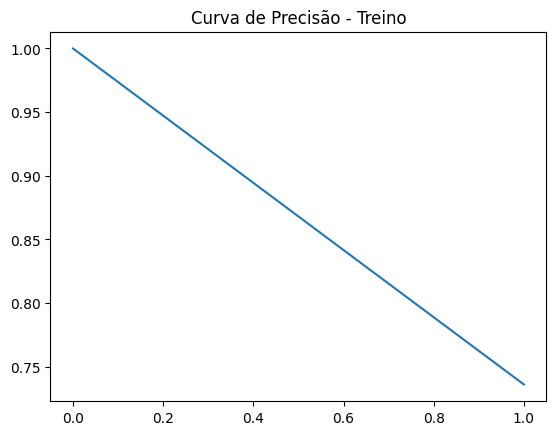

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         1
           1       0.00      0.00      0.00         1
           2       0.00      0.00      0.00         1
           3       0.00      0.00      0.00         1
           4       1.00      1.00      1.00         1
           5       0.00      0.00      0.00         1
           6       0.00      0.00      0.00         1
           7       0.00      0.00      0.00         1
           8       0.00      0.00      0.00         1
           9       0.00      0.00      0.00         1
          10       0.00      0.00      0.00         1
          11       0.00      0.00      0.00         1
          12       1.00      1.00      1.00         1
          13       1.00      1.00      1.00         1
          14       1.00      1.00      1.00         1
          15       1.00      1.00      1.00         1
          16       1.00      1.00      1.00         1
          17       1.00    

C:\Users\kamil\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\kamil\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\kamil\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\metrics\_classification.py:15

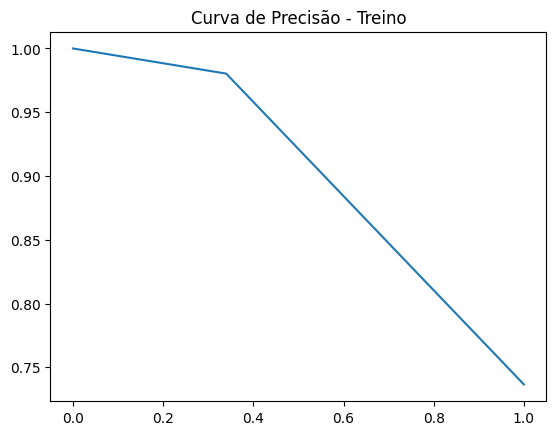

In [21]:
#incompleto - falta verificar umas coisas

from sklearn.metrics import precision_recall_curve, classification_report

for cls in classes:
    report = classification_report(y_train_bin[cls], y_pred_treino[cls])
    #precisão x sensibilidade*
    precision, recall, _ = precision_recall_curve(y_train_bin[cls].flatten(), y_pred_treino[cls].flatten())

    print(report)

    plt.plot(recall, precision)
    plt.title('Curva de Precisão - Treino')
    plt.show()

#### Falta o F1-score

### Eficiência da Classificação

In [22]:
for cls in classes:
    print(f"Para a classe {cls}")
    acuracia(y_train_bin[cls], y_pred_treino[cls], "teste")
    print('')

Para a classe 0
Acuracia do modelo no conjunto teste:  84.26349496797805 %

Para a classe 1
Acuracia do modelo no conjunto teste:  97.80420860018299 %

Para a classe 4
Acuracia do modelo no conjunto teste:  73.60475754803294 %

Para a classe 5
Acuracia do modelo no conjunto teste:  50.86916742909423 %



In [23]:
from sklearn.metrics import mean_squared_error, mean_absolute_error

for cls in classes:
    
    print(f'Metricas de Erro - Treino {cls}')
    print("Erro médio quadrático: ", mean_squared_error(y_train_bin[cls], y_pred_treino[cls]))
    print("Erro médio absoluto: ", mean_absolute_error(y_train_bin[cls], y_pred_treino[cls]))
    print('')

Metricas de Erro - Treino 0
Erro médio quadrático:  0.15736505032021958
Erro médio absoluto:  0.15736505032021958

Metricas de Erro - Treino 1
Erro médio quadrático:  0.021957913998170174
Erro médio absoluto:  0.021957913998170174

Metricas de Erro - Treino 4
Erro médio quadrático:  0.26395242451967066
Erro médio absoluto:  0.26395242451967066

Metricas de Erro - Treino 5
Erro médio quadrático:  0.49130832570905764
Erro médio absoluto:  0.49130832570905764

